# Imports

In [35]:
import torch
import sympy

# Custom Module (SymXplorer)
from symxplorer.symbolic_solver.domains    import ExperimentResult

from symxplorer.designer_tools.utils       import Transfer_Func_Helper
from symxplorer.designer_tools.symbolic_sizing import Symbolic_Sizing_Assist
from symxplorer.designer_tools.visualizer  import Symbolic_Visualizer
from symxplorer.designer_tools.tf_models   import First_Order_LP_TF, Second_Order_LP_TF, Second_Order_BP_TF, Pole_Zero_TF, cascade_tf
# Optimizer wrapper
from symxplorer.designer_tools.bayesian_ax import Ax_Symbolic_Bode_Fitter

helper_funcs = Transfer_Func_Helper()


In [2]:
path_to_pkl = "Runs/results.pkl"
symbolic_experiment_result = ExperimentResult("Sizing Stage")
symbolic_experiment_result = symbolic_experiment_result.load(path_to_pkl)

# First Order Filter

## Setting the Target

In [3]:
target_tf = First_Order_LP_TF(fc=1e3, dc_gain=20)
target_tf = target_tf.get_tf()
target_tf

20/(0.0005*s/pi + 1)

Calculating Phases: 100%|██████████| 20/20 [00:00<00:00, 527.79it/s]


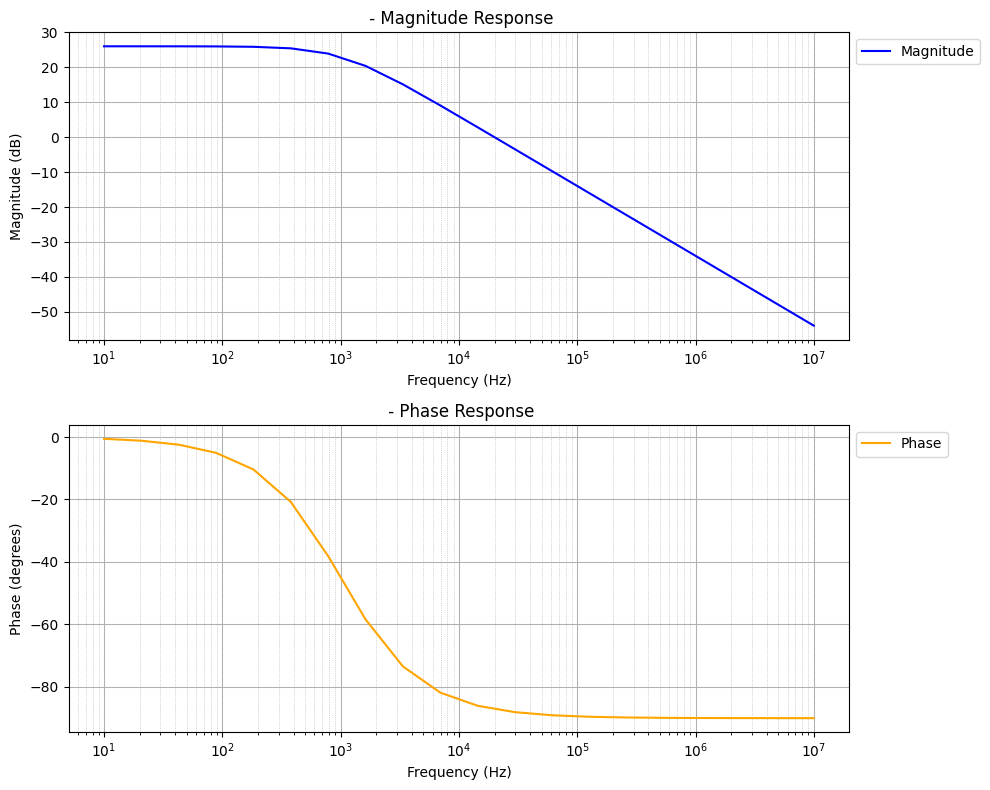

In [4]:
Symbolic_Visualizer(tf=target_tf).visualize(1, 7)

## Setting the Symbolic TF to Size

In [5]:
# Manual overwrite
s = sympy.symbols("s")

R1, R2, R3, R4 = sympy.symbols("R_1, R_2, R_3 R_4")
C1, C2, C3     = sympy.symbols("C_1, C_2, C_3")

# tf_expr_symbolic =  R1*R2/C2*s/(s**2 + R4/(R3*C3)*s + 1/(R3*C3))
tf_expr_symbolic =  R1*R2/(s + 1/(R3*C3))
tf_expr_symbolic

R_1*R_2/(s + 1/(C_3*R_3))

Calculating Phases: 100%|██████████| 20/20 [00:00<00:00, 257.63it/s]


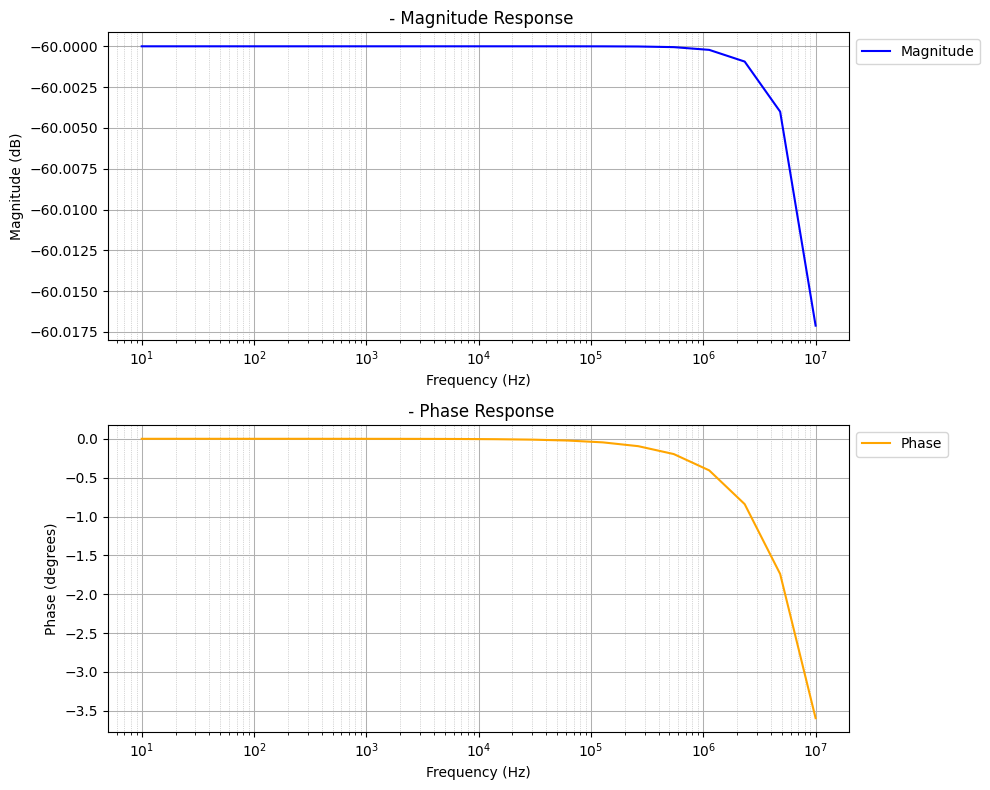

In [6]:
vis = Symbolic_Visualizer(tf=tf_expr_symbolic)

vis.set_params({
    "R_1" : 1e3,
    "R_2" : 1e3,
    "R_3" : 1e3,
    "C_3" : 1e-12
})

vis.visualize()

## Automated Sizing

In [7]:
frequencies = torch.logspace(1, 6, 1000)
ax_wrapper = Ax_Symbolic_Bode_Fitter(
                    tf_to_size=tf_expr_symbolic,
                    target_tf= target_tf,
                    mag_threshold= -10,
                    c_range=[1e-12, 10e-9],
                    r_range=[1e2, 1e6],
                    frequencies=frequencies,
                    freq_weights= None,
                    max_loss= float('inf'),
                    loss_norm_method='min-max',
                    rescale_mag=True,
                    random_seed=42
                        )

[INFO 02-11 10:03:47] ax.utils.notebook.plotting: Injecting Plotly library into cell. Do not overwrite or delete cell.
[INFO 02-11 10:03:47] ax.utils.notebook.plotting: Please see
    (https://ax.dev/tutorials/visualizations.html#Fix-for-plots-that-are-not-rendering)
    if visualizations are not rendering.


Computing filter parameters for BiQuad:   0%|          | 0/1 [00:00<?, ?filter/s]


In [18]:
ax_wrapper.parameterize(log_scale=True)
ax_wrapper.create_experiment(num_sobol_trials=5, use_outcome_constraint=True) # Constraints mag to be greater than min. If false constraint violation is added as penalty to the loss

[INFO 02-11 10:09:57] ax.service.ax_client: Starting optimization with verbose logging. To disable logging, set the `verbose_logging` argument to `False`. Note that float values in the logs are rounded to 6 decimal points.
[WARNING 02-11 10:09:57] ax.service.ax_client: Random seed set to 42. Note that this setting only affects the Sobol quasi-random generator and BoTorch-powered Bayesian optimization models. For the latter models, setting random seed to the same number for two optimizations will make the generated trials similar, but not exactly the same, and over time the trials will diverge more.
[INFO 02-11 10:09:57] ax.service.utils.instantiation: Created search space: SearchSpace(parameters=[RangeParameter(name='C_3', parameter_type=FLOAT, range=[1.0, 10000.0], log_scale=True), RangeParameter(name='R_1', parameter_type=FLOAT, range=[1.0, 10000.0], log_scale=True), RangeParameter(name='R_3', parameter_type=FLOAT, range=[1.0, 10000.0], log_scale=True), RangeParameter(name='R_2', par

In [19]:
ax_wrapper.optimize(80)

Optimizing:   0%|          | 0/80 [00:00<?, ?trial/s]/Users/danialnoorizadeh/.pyenv/versions/myenv/lib/python3.12/site-packages/ax/modelbridge/cross_validation.py:463: UserWarning:

Encountered exception in computing model fit quality: RandomModelBridge does not support prediction.

[INFO 02-11 10:10:12] ax.service.ax_client: Generated new trial 0 with parameters {'C_3': 9773.571704, 'R_1': 2.614963, 'R_3': 1958.462668, 'R_2': 47.61334} using model Sobol.
[INFO 02-11 10:10:12] ax.service.ax_client: Completed trial 0 with data: {'tf_fitting_loss': (tensor(20.), 0.0), 'max_mag': (tensor(67.4809, dtype=torch.float32), 0), 'l1norm': (tensor(200869.0971), 0)}.
Optimizing:   1%|▏         | 1/80 [00:00<00:10,  7.33trial/s]/Users/danialnoorizadeh/.pyenv/versions/myenv/lib/python3.12/site-packages/ax/modelbridge/cross_validation.py:463: UserWarning:

Encountered exception in computing model fit quality: RandomModelBridge does not support prediction.

[INFO 02-11 10:10:12] ax.service.ax_client: 

## Visualization

In [20]:
params, index = ax_wrapper.get_best()
params

{'C_3': 1.430450595698831e-10,
 'R_1': 3170.2526950361184,
 'R_3': 1000000.0,
 'R_2': 235522.29979120666}

In [21]:
ax_wrapper.plot_solution(params)

mag_loss 0.061203584471307707, phase_loss 0.17151532004780598, max-mag 100.57162475585938


In [12]:
ax_wrapper.render_contour_plot("R_3", "C_3")

[INFO 02-11 10:05:38] ax.service.ax_client: Retrieving contour plot with parameter 'R_3' on X-axis and 'C_3' on Y-axis, for metric 'tf_fitting_loss'. Remaining parameters are affixed to the middle of their range.


# Second Order BP Filters

In [3]:
bp_filters = symbolic_experiment_result.get_filter_types("BP")

In [4]:
idx = 10
tf_expr_symbolic = bp_filters[idx].transferFunc
tf_expr_symbolic

C_3*R_1*R_2*R_4*R_6*s/(-R_2*R_4 + R_2*R_5 + R_4*R_5 + s**2*(C_3*C_6*R_1*R_4*R_5*R_6 + C_3*C_6*R_2*R_4*R_5*R_6 + C_4*C_6*R_2*R_4*R_5*R_6) + s*(C_3*R_1*R_4*R_5 + C_3*R_2*R_4*R_5 + C_4*R_2*R_4*R_5 - C_6*R_2*R_4*R_6 + C_6*R_2*R_5*R_6 + C_6*R_4*R_5*R_6))

## Setting Up the Target

In [5]:
frequencies = torch.logspace(1, 9, 20000)
target_tf = Second_Order_BP_TF(q=3, fc=1e6, k_bp=1)
target_tf = target_tf.get_tf()
target_tf

666666.666666667*pi*s/(s**2 + 666666.666666667*pi*s + 4000000000000.0*pi**2)

In [6]:
# Define range
lower_bound = 0.1e6
upper_bound = 10e6

# Generate binary mask
weighted_frequencies = torch.where((frequencies >= lower_bound) & (frequencies <= upper_bound), 1, 0.8)

## Optimization

In [20]:
ax_wrapper = Ax_Symbolic_Bode_Fitter(
                    tf_to_size=tf_expr_symbolic,
                    target_tf= target_tf,
                    mag_threshold=0,
                    c_range=[1e-12, 1e-9],
                    r_range=[1e0, 1e5],
                    frequencies=frequencies,
                    freq_weights=weighted_frequencies,
                    max_loss=float('inf'),
                    loss_norm_method="min-max", # choose from None, 'min-max', and 'z-score'
                    random_seed=90
                )

# ax_wrapper.sizing_assist.kill_variable("R_4", "R_1")
# ax_wrapper.sizing_assist.kill_variable("C_6", "C_4")

[INFO 02-11 10:29:21] ax.utils.notebook.plotting: Injecting Plotly library into cell. Do not overwrite or delete cell.
[INFO 02-11 10:29:21] ax.utils.notebook.plotting: Please see
    (https://ax.dev/tutorials/visualizations.html#Fix-for-plots-that-are-not-rendering)
    if visualizations are not rendering.


Computing filter parameters for BiQuad:   0%|          | 0/1 [00:00<?, ?filter/s]


In [22]:
ax_wrapper.parameterize(log_scale=True)
ax_wrapper.create_experiment(
    num_sobol_trials  = 5, use_outcome_constraint=True)

[INFO 02-11 10:29:33] ax.service.ax_client: Starting optimization with verbose logging. To disable logging, set the `verbose_logging` argument to `False`. Note that float values in the logs are rounded to 6 decimal points.
[WARNING 02-11 10:29:33] ax.service.ax_client: Random seed set to 90. Note that this setting only affects the Sobol quasi-random generator and BoTorch-powered Bayesian optimization models. For the latter models, setting random seed to the same number for two optimizations will make the generated trials similar, but not exactly the same, and over time the trials will diverge more.
[INFO 02-11 10:29:33] ax.service.utils.instantiation: Created search space: SearchSpace(parameters=[RangeParameter(name='C_3', parameter_type=FLOAT, range=[1.0, 1000.0000000000001], log_scale=True), RangeParameter(name='R_2', parameter_type=FLOAT, range=[1.0, 100000.0], log_scale=True), RangeParameter(name='R_6', parameter_type=FLOAT, range=[1.0, 100000.0], log_scale=True), RangeParameter(na

In [23]:
ax_wrapper.optimize(num_trials=40, include_mag_loss=True, include_phase_loss=True)

Optimizing:   0%|          | 0/40 [00:00<?, ?trial/s]/Users/danialnoorizadeh/.pyenv/versions/myenv/lib/python3.12/site-packages/ax/modelbridge/cross_validation.py:463: UserWarning:

Encountered exception in computing model fit quality: RandomModelBridge does not support prediction.

[INFO 02-11 10:29:35] ax.service.ax_client: Generated new trial 0 with parameters {'C_3': 1.632314, 'R_2': 2.351499, 'R_6': 34601.701802, 'C_4': 832.56097, 'R_5': 3211.79064, 'R_4': 15.772861, 'R_1': 485.950359, 'C_6': 766.236752} using model Sobol.
[INFO 02-11 10:29:35] ax.service.ax_client: Completed trial 0 with data: {'tf_fitting_loss': (tensor(4377.0240), 0.0), 'max_mag': (tensor(-63.6097, dtype=torch.float32), 0), 'l1norm': (tensor(38317.5672), 0)}.
Optimizing:   2%|▎         | 1/40 [00:00<00:10,  3.86trial/s]/Users/danialnoorizadeh/.pyenv/versions/myenv/lib/python3.12/site-packages/ax/modelbridge/cross_validation.py:463: UserWarning:

Encountered exception in computing model fit quality: RandomModelB

KeyboardInterrupt: 

## Visualization

In [24]:
params, index = ax_wrapper.get_best()
params

{'C_3': 1.4720194858146112e-12,
 'R_2': 16.726359344831177,
 'R_6': 4480.088933534791,
 'C_4': 1e-12,
 'R_5': 185.1394685899352,
 'R_4': 8801.279182143722,
 'R_1': 100000.0,
 'C_6': 4.3989723258456553e-11}

In [25]:
ax_wrapper.plot_solution(params)

mag_loss 18.42022514855221, phase_loss 17.163795633851766, max-mag 45.2140007019043


In [31]:
selected_params = ax_wrapper.ax_client.get_trial_parameters(20)
selected_params = ax_wrapper.denormalize_params(selected_params)
print(selected_params)
ax_wrapper.plot_solution(selected_params)

{'C_3': 1.4720194858146112e-12, 'R_2': 16.726359344831177, 'R_6': 4480.088933534791, 'C_4': 1e-12, 'R_5': 185.1394685899352, 'R_4': 8801.279182143722, 'R_1': 100000.0, 'C_6': 4.3989723258456553e-11}
mag_loss 18.42022514855221, phase_loss 17.163795633851766, max-mag 45.2140007019043


In [32]:
(ax_wrapper.sizing_assist.tf)

C_3*R_1*R_2*R_4*R_6*s/(-R_2*R_4 + R_2*R_5 + R_4*R_5 + s**2*(C_3*C_6*R_1*R_4*R_5*R_6 + C_3*C_6*R_2*R_4*R_5*R_6 + C_4*C_6*R_2*R_4*R_5*R_6) + s*(C_3*R_1*R_4*R_5 + C_3*R_2*R_4*R_5 + C_4*R_2*R_4*R_5 - C_6*R_2*R_4*R_6 + C_6*R_2*R_5*R_6 + C_6*R_4*R_5*R_6))

In [33]:
ax_wrapper.sizing_assist.sub_val_design_vars(params).expand()

97.0839447259379*s/(4.7284435319742e-8*s**2 + 0.532656798369534*s + 1485347.50167958)

In [34]:
ax_wrapper.render_contour_plot("R_1", "C_4")

[INFO 02-11 10:36:11] ax.service.ax_client: Retrieving contour plot with parameter 'R_1' on X-axis and 'C_4' on Y-axis, for metric 'tf_fitting_loss'. Remaining parameters are affixed to the middle of their range.


# Second Order LP Filter

In [83]:
lp_filters = symbolic_experiment_result.get_filter_types("LP")

In [ ]:
idx = 5
tf_expr_symbolic = lp_filters[idx].transferFunc
tf_expr_symbolic

In [ ]:
frequencies = torch.logspace(1, 9, 20000)
target_tf = Second_Order_LP_TF(q=3, fc=1e7, dc_gain=1)
target_tf = target_tf.get_tf()
target_tf

In [86]:
# Define range
lower_bound = 0.5e4
upper_bound = 5e4

# Generate binary mask
weighted_frequencies = torch.where((frequencies >= lower_bound) & (frequencies <= upper_bound), 1, 1)

In [ ]:
ax_wrapper = Ax_Symbolic_Bode_Fitter(
                    tf_to_size=tf_expr_symbolic,
                    target_tf= target_tf,
                    c_range=[1e-12, 100e-9],
                    r_range=[1e0, 1e5],
                    frequencies=frequencies,
                    freq_weights=weighted_frequencies,
                    max_loss=50,
                    loss_norm_method="z-score", # choose from None, 'min-max', and 'z-score'
                    random_seed=42
                )

# ax_wrapper.sizing_assist.kill_variable("R_4", "R_1")
# ax_wrapper.sizing_assist.kill_variable("C_6", "C_4")
ax_wrapper.parameterize(log_scale=True)
ax_wrapper.create_experiment(
    num_sobol_trials  = 20,
    max_parallelism_bo= 3
)
ax_wrapper.optimize(num_trials=40, include_mag_loss=True, include_phase_loss=True)

In [ ]:
params, index = ax_wrapper.get_best()
params

In [ ]:
ax_wrapper.plot_solution(params)

In [ ]:
ax_wrapper.optimize(num_trials=20, include_mag_loss=True, include_phase_loss=True)

In [ ]:
params, index = ax_wrapper.get_best()
params

In [ ]:
ax_wrapper.plot_solution(params)

# Third Order LP

In [36]:
selected_filters = symbolic_experiment_result.get_filter_types("X-INVALID-ORDER")
len(selected_filters)

3190

In [37]:
idx = 2365 # 2365 is the ID of our case study

z_key = selected_filters[idx].zCombo
tf_expr_symbolic = selected_filters[idx].transferFunc
tf_expr_symbolic

R_1*R_2*R_6/(C_1*C_4*C_6*R_1*R_2*R_3*R_5*R_6*s**3 + R_1*R_5 - R_2*R_3 + R_2*R_5 + R_3*R_5 + s**2*(C_1*C_4*R_1*R_2*R_3*R_5 - C_1*C_6*R_1*R_2*R_3*R_6 + C_1*C_6*R_1*R_2*R_5*R_6 + C_1*C_6*R_1*R_3*R_5*R_6 + C_4*C_6*R_2*R_3*R_5*R_6) + s*(-C_1*R_1*R_2*R_3 + C_1*R_1*R_2*R_5 + C_1*R_1*R_3*R_5 + C_4*R_2*R_3*R_5 + C_6*R_1*R_5*R_6 - C_6*R_2*R_3*R_6 + C_6*R_2*R_5*R_6 + C_6*R_3*R_5*R_6))

In [38]:
frequencies = torch.logspace(4, 10, 2000)

# Butterworth Filter (3rd order)
fc = 1e7
tf1 = Second_Order_LP_TF(q=1, fc=1.272*fc, dc_gain=1e3)
tf2 = First_Order_LP_TF(fc=1*fc, dc_gain=1)

target_tf = cascade_tf(list_of_tfs=[tf1, tf2], dc_gain_multiplier=1)
target_tf

1000.0/((5.0e-8*s/pi + 1)*(1.54513270835806e-15*s**2/pi**2 + 3.93081761006289e-8*s/pi + 1))

In [39]:
# Define range
lower_bound = 1e6
upper_bound = 12e6

# Generate binary mask
weighted_frequencies = torch.where((frequencies >= lower_bound) & (frequencies <= upper_bound), 1, 0.1)

In [50]:
ax_wrapper = Ax_Symbolic_Bode_Fitter(
                    tf_to_size=tf_expr_symbolic,
                    target_tf= target_tf,
                    mag_threshold=20, # in dB
                    # optional (defaults to a pre-defined setting if not specified)
                    c_range=[1e-12, 1e-9],
                    r_range=[1e2, 1e5],
                    frequencies=frequencies,
                    freq_weights=weighted_frequencies,
                    max_loss=float('inf'),
                    loss_norm_method='min-max', # choose from None, 'min-max', and 'z-score'
                    loss_type= 'mse',
                    rescale_mag=True,
                    random_seed=42
                )

ax_wrapper.sizing_assist.kill_variable("C_4", "C_1")
ax_wrapper.sizing_assist.kill_variable("C_6", "C_1")

ax_wrapper.parameterize(log_scale=True)
ax_wrapper.create_experiment(
    num_sobol_trials  = 10,
    use_outcome_constraint=True
    )

[INFO 02-11 10:50:02] ax.utils.notebook.plotting: Injecting Plotly library into cell. Do not overwrite or delete cell.
[INFO 02-11 10:50:02] ax.utils.notebook.plotting: Please see
    (https://ax.dev/tutorials/visualizations.html#Fix-for-plots-that-are-not-rendering)
    if visualizations are not rendering.


Computing filter parameters for BiQuad:   0%|          | 0/1 [00:00<?, ?filter/s]
[INFO 02-11 10:50:02] ax.service.ax_client: Starting optimization with verbose logging. To disable logging, set the `verbose_logging` argument to `False`. Note that float values in the logs are rounded to 6 decimal points.
[WARNING 02-11 10:50:02] ax.service.ax_client: Random seed set to 42. Note that this setting only affects the Sobol quasi-random generator and BoTorch-powered Bayesian optimization models. For the latter models, setting random seed to the same number for two optimizations will make the generated trials similar, but not exactly the same, and over time the trials will diverge more.
[INFO 02-11 10:50:02] ax.service.utils.instantiation: Created search space: SearchSpace(parameters=[RangeParameter(name='R_2', parameter_type=FLOAT, range=[1.0, 1000.0], log_scale=True), RangeParameter(name='R_6', parameter_type=FLOAT, range=[1.0, 1000.0], log_scale=True), RangeParameter(name='R_5', parameter_t

In [51]:
ax_wrapper.optimize(num_trials=50, include_mag_loss=True, include_phase_loss=True)

Optimizing:   0%|          | 0/50 [00:00<?, ?trial/s]

/Users/danialnoorizadeh/.pyenv/versions/myenv/lib/python3.12/site-packages/ax/modelbridge/cross_validation.py:463: UserWarning:

Encountered exception in computing model fit quality: RandomModelBridge does not support prediction.

[INFO 02-11 10:50:06] ax.service.ax_client: Generated new trial 0 with parameters {'R_2': 982.969353, 'R_6': 2.05636, 'R_5': 294.399097, 'R_3': 18.125771, 'R_1': 38.456187, 'C_1': 1.474763} using model Sobol.
[INFO 02-11 10:50:06] ax.service.ax_client: Completed trial 0 with data: {'tf_fitting_loss': (tensor(1658.0898), 0.0), 'max_mag': (tensor(28.6174, dtype=torch.float32), 0), 'l1norm': (tensor(133600.6768), 0)}.
Optimizing:   2%|▏         | 1/50 [00:00<00:07,  6.91trial/s]/Users/danialnoorizadeh/.pyenv/versions/myenv/lib/python3.12/site-packages/ax/modelbridge/cross_validation.py:463: UserWarning:

Encountered exception in computing model fit quality: RandomModelBridge does not support prediction.

[INFO 02-11 10:50:06] ax.service.ax_client: Generated new 

In [52]:
params, index = ax_wrapper.get_best()
params

{'R_2': 28811.166314649086,
 'R_6': 825.7275571688641,
 'R_5': 515.4032292494821,
 'R_3': 117.18323689651633,
 'R_1': 1948.3573033638368,
 'C_1': 1.7386373827163776e-11}

In [53]:
ax_wrapper.plot_solution(params)

mag_loss 4.327618469766654, phase_loss 69.0718079008328, max-mag 71.35689544677734


In [44]:
ax_wrapper.render_contour_plot(param_x="C_1", param_y="R_1")
ax_wrapper.render_contour_plot(param_x="C_1", param_y="R_2")
ax_wrapper.render_contour_plot(param_x="C_1", param_y="R_3")
ax_wrapper.render_contour_plot(param_x="C_1", param_y="R_5")
ax_wrapper.render_contour_plot(param_x="C_1", param_y="R_6")

ax_wrapper.render_contour_plot(param_x="R_1", param_y="R_2")
ax_wrapper.render_contour_plot(param_x="R_1", param_y="R_3")
ax_wrapper.render_contour_plot(param_x="R_1", param_y="R_5")
ax_wrapper.render_contour_plot(param_x="R_1", param_y="R_6")

ax_wrapper.render_contour_plot(param_x="R_2", param_y="R_3")
ax_wrapper.render_contour_plot(param_x="R_2", param_y="R_5")
ax_wrapper.render_contour_plot(param_x="R_2", param_y="R_6")

[INFO 02-11 10:42:46] ax.service.ax_client: Retrieving contour plot with parameter 'C_1' on X-axis and 'R_1' on Y-axis, for metric 'tf_fitting_loss'. Remaining parameters are affixed to the middle of their range.


[INFO 02-11 10:42:47] ax.service.ax_client: Retrieving contour plot with parameter 'C_1' on X-axis and 'R_2' on Y-axis, for metric 'tf_fitting_loss'. Remaining parameters are affixed to the middle of their range.


[INFO 02-11 10:42:49] ax.service.ax_client: Retrieving contour plot with parameter 'C_1' on X-axis and 'R_3' on Y-axis, for metric 'tf_fitting_loss'. Remaining parameters are affixed to the middle of their range.


[INFO 02-11 10:42:51] ax.service.ax_client: Retrieving contour plot with parameter 'C_1' on X-axis and 'R_5' on Y-axis, for metric 'tf_fitting_loss'. Remaining parameters are affixed to the middle of their range.


[INFO 02-11 10:42:51] ax.service.ax_client: Retrieving contour plot with parameter 'C_1' on X-axis and 'R_6' on Y-axis, for metric 'tf_fitting_loss'. Remaining parameters are affixed to the middle of their range.


[INFO 02-11 10:42:52] ax.service.ax_client: Retrieving contour plot with parameter 'R_1' on X-axis and 'R_2' on Y-axis, for metric 'tf_fitting_loss'. Remaining parameters are affixed to the middle of their range.


[INFO 02-11 10:42:53] ax.service.ax_client: Retrieving contour plot with parameter 'R_1' on X-axis and 'R_3' on Y-axis, for metric 'tf_fitting_loss'. Remaining parameters are affixed to the middle of their range.


[INFO 02-11 10:42:53] ax.service.ax_client: Retrieving contour plot with parameter 'R_1' on X-axis and 'R_5' on Y-axis, for metric 'tf_fitting_loss'. Remaining parameters are affixed to the middle of their range.


[INFO 02-11 10:42:54] ax.service.ax_client: Retrieving contour plot with parameter 'R_1' on X-axis and 'R_6' on Y-axis, for metric 'tf_fitting_loss'. Remaining parameters are affixed to the middle of their range.


[INFO 02-11 10:42:55] ax.service.ax_client: Retrieving contour plot with parameter 'R_2' on X-axis and 'R_3' on Y-axis, for metric 'tf_fitting_loss'. Remaining parameters are affixed to the middle of their range.


[INFO 02-11 10:42:56] ax.service.ax_client: Retrieving contour plot with parameter 'R_2' on X-axis and 'R_5' on Y-axis, for metric 'tf_fitting_loss'. Remaining parameters are affixed to the middle of their range.


[INFO 02-11 10:42:56] ax.service.ax_client: Retrieving contour plot with parameter 'R_2' on X-axis and 'R_6' on Y-axis, for metric 'tf_fitting_loss'. Remaining parameters are affixed to the middle of their range.


Calculating Phases: 100%|██████████| 500/500 [00:06<00:00, 78.59it/s] 


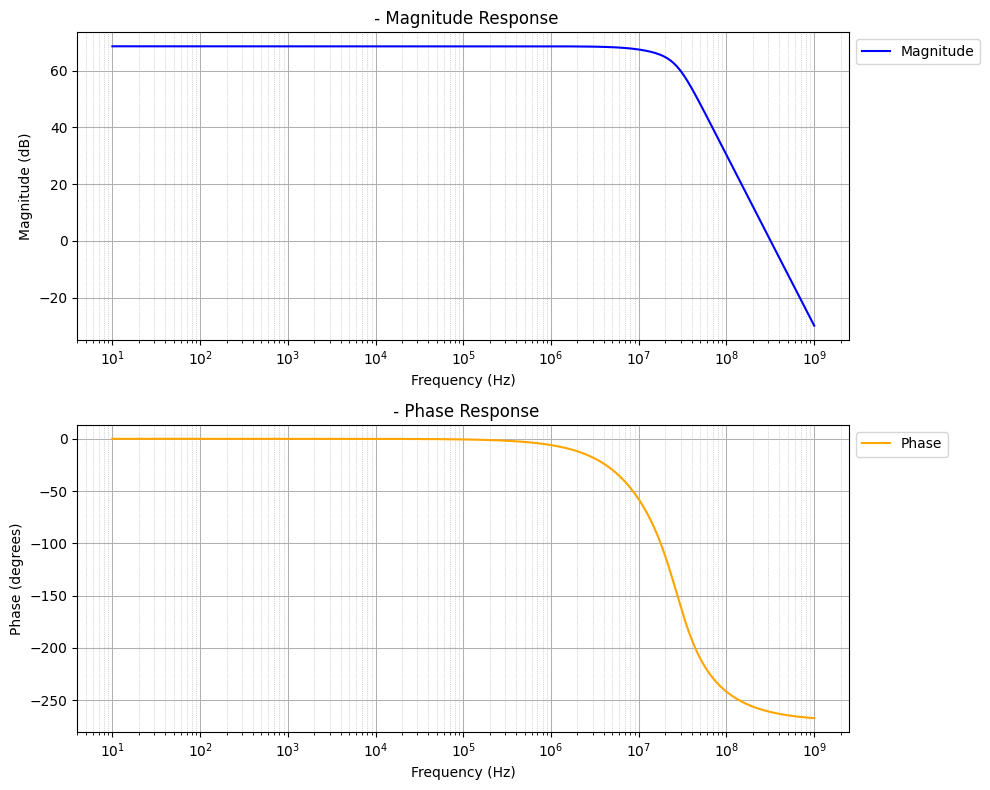

In [45]:
# Manual Solution
assist = ax_wrapper.sizing_assist
assist.visualizer.set_params({
    "C_1" : 5e-12,
    "C_4" : 5e-12,
    "C_6" : 5e-12,
    "R_1" : 2e3,
    "R_2" : 2e3,
    "R_3" : 1e3,
    "R_5" : 1e3,
    "R_6": 2e3,
})

assist.visualizer.visualize(1, 9, 500)